<a href="https://colab.research.google.com/github/AMROAMRO404/Pothole-street-detection/blob/main/pothole_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount("/content/gdrive")
# tf.keras.backend.clear_session()

Mounted at /content/gdrive


# **Install Yolov5**

In [2]:
# YOLOV5
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -U -r yolov5/requirements.txt  # install dependencies
%cd /content/yolov5
# ******************************************************************************
!pip install -r requirements.txt  # install dependencies
%cd yolov5
# ******************************************************************************
import torch
from IPython.display import Image  # for displaying images
#from utils.google_utils import gdrive_download  # for downloading models/datasets

print('torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))
# ******************************************************************************

Cloning into 'yolov5'...
remote: Enumerating objects: 8797, done.
remote: Counting objects: 100% (43/43), done.
remote: Compressing objects: 100% (37/37), done.
remote: Total 8797 (delta 18), reused 9 (delta 6), pack-reused 8754
Receiving objects: 100% (8797/8797), 9.35 MiB | 17.87 MiB/s, done.
Resolving deltas: 100% (6105/6105), done.
     |████████████████████████████████| 10.3 MB 8.5 MB/s 
     |████████████████████████████████| 15.7 MB 75 kB/s 
     |████████████████████████████████| 49.9 MB 14 kB/s 
     |████████████████████████████████| 3.0 MB 32.6 MB/s 
     |████████████████████████████████| 636 kB 62.7 MB/s 
     |████████████████████████████████| 28.5 MB 47 kB/s 
     |████████████████████████████████| 76 kB 5.9 MB/s 
     |████████████████████████████████| 5.6 MB 56.5 MB/s 
     |████████████████████████████████| 11.5 MB 65.6 MB/s 
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillo

/content/yolov5
[Errno 2] No such file or directory: 'yolov5'
/content/yolov5
torch 1.9.0+cu102 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


# **Custom Dataset**

In [3]:
# Download Custom Dataset
%mkdir /content/my_dataset/
%cd /content/my_dataset
!curl -L "https://public.roboflow.com/ds/NEbdAjTGUx?key=kiNIE1s0A0" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content/my_dataset
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1415      0 --:--:-- --:--:-- --:--:--  1413
100 46.0M  100 46.0M    0     0  37.5M      0  0:00:01  0:00:01 --:--:-- 37.5M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg  
 extracting: test/images/img-107_jpg.rf.2e40485785f6e5e2efec404301b235c2.jpg  
 extracting: test/images/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.jpg  
 extracting: test/images/img-161_jpg.rf.211541e7178a4a93ec0680f26b905427.jpg  
 extracting: test/images/img-168_jpg.rf.af3590e07b06b43e91fa53990ff94af3.jpg  
 extracting: test/images/img-179_jpg.rf.8632eb0d9b75fefe144829e67b75015a.jpg  
 extract

In [1]:
# new torch for using GPU
!pip install torch==1.7.1+cu101 torchvision==0.8.2+cu101 -f https://download.pytorch.org/whl/torch_stable.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html


In [9]:
# Train Yolov5 on Custom Dataset
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 50 --data /content/my_dataset/data.yaml --cfg /content/yolov5/models/hub/pothole_model.yaml --weights yolov5l.pt --name pothole_model_results --cache


/content/yolov5
train: weights=yolov5l.pt, cfg=/content/yolov5/models/hub/pothole_model.yaml, data=/content/my_dataset/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=pothole_model_results, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-358-g3e7c59a torch 1.7.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0

In [10]:
# Export Saved YOLOv5 Weights for Future Inference
"""
from google.colab import drive
drive.mount("/content/gdrive")
"""
%cp /content/yolov5/runs/train/pothole_model_results5/weights/best.pt  /content/gdrive/MyDrive

print("Done ...")

Done ...


In [11]:
# Evaluate Custom YOLOV5 Detector Performance
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

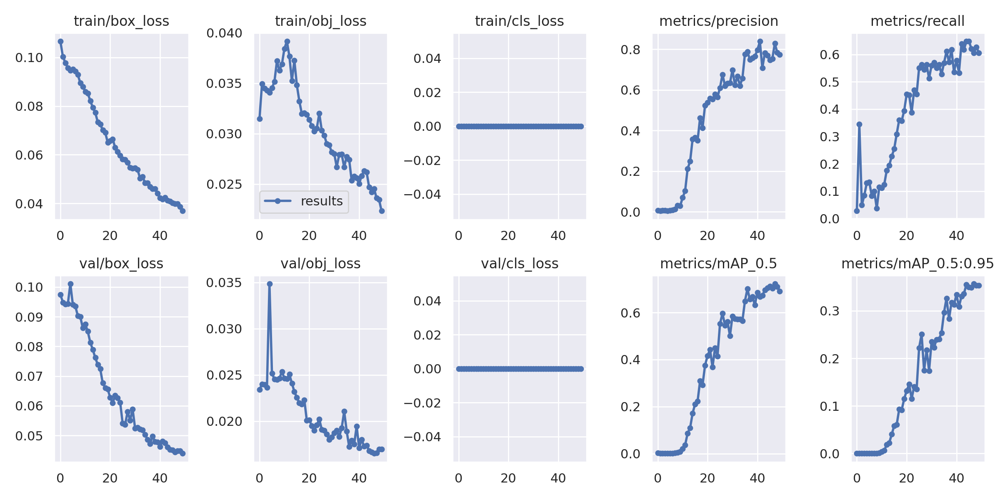

In [12]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from IPython.display import Image
Image(filename="/content/yolov5/runs/train/pothole_model_results5/results.png", width=1000)  # view results.png


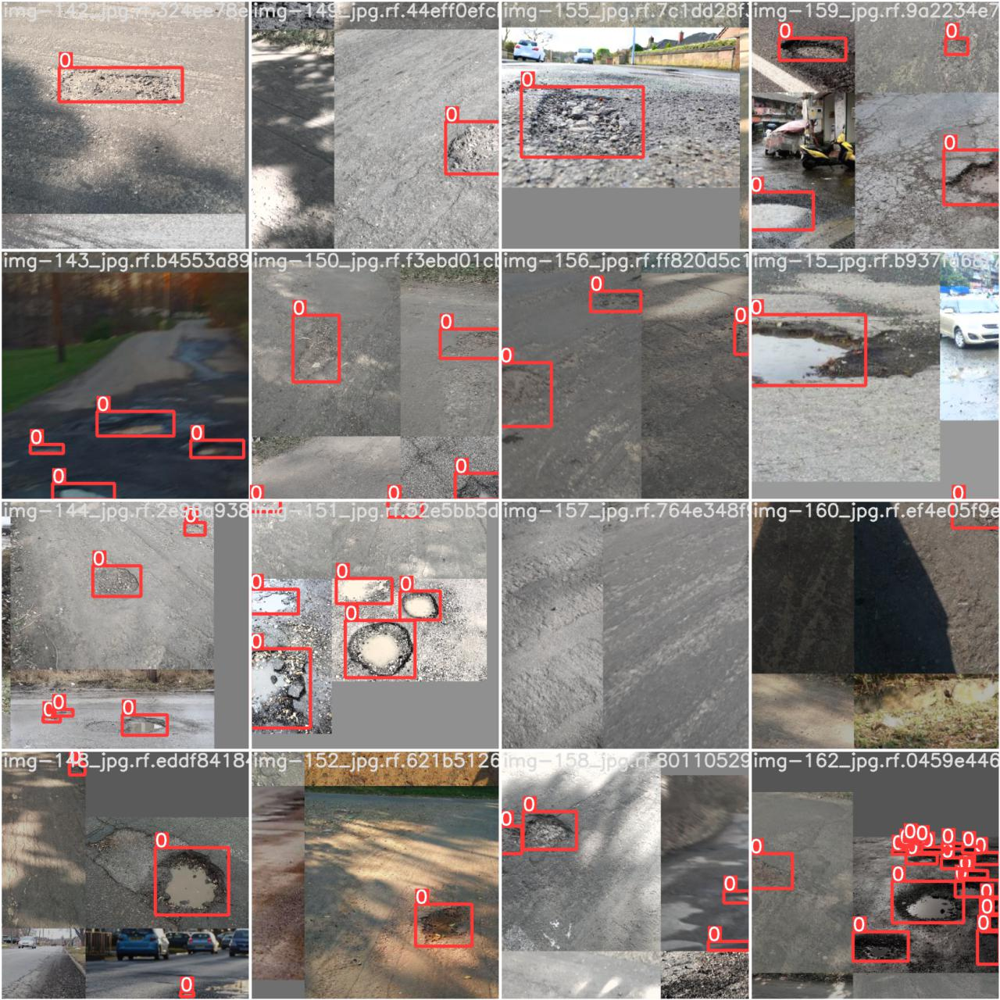

In [13]:
# display our ground truth data
Image(filename="/content/yolov5/runs/train/pothole_model_results5/train_batch2.jpg", width=900)

In [14]:
%cd /content/yolov5/
!python val.py --weights /content/yolov5/runs/train/pothole_model_results5/weights/best.pt --data /content/my_dataset/data.yaml --name my_yolo_model

/content/yolov5
val: data=/content/my_dataset/data.yaml, weights=['/content/yolov5/runs/train/pothole_model_results5/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, task=val, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=my_yolo_model, exist_ok=False, half=False
YOLOv5 🚀 v5.0-358-g3e7c59a torch 1.7.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 369 layers, 49808694 parameters, 0 gradients, 117.0 GFLOPs
val: Scanning '/content/my_dataset/valid/labels.cache' images and labels... 133 found, 0 missing, 0 empty, 0 corrupted: 100% 133/133 [00:00<?, ?it/s]
val: Scanning '/content/my_dataset/valid/labels.cache' images and labels... 133 found, 0 missing, 0 empty, 0 corrupted: 100% 133/133 [00:00<?, ?it/s]
val: Scanning '/content/my_dataset/valid/labels.cache' images and labels... 133 found, 0 missing, 0 empty, 0 corrupted: 100% 133/133 [00

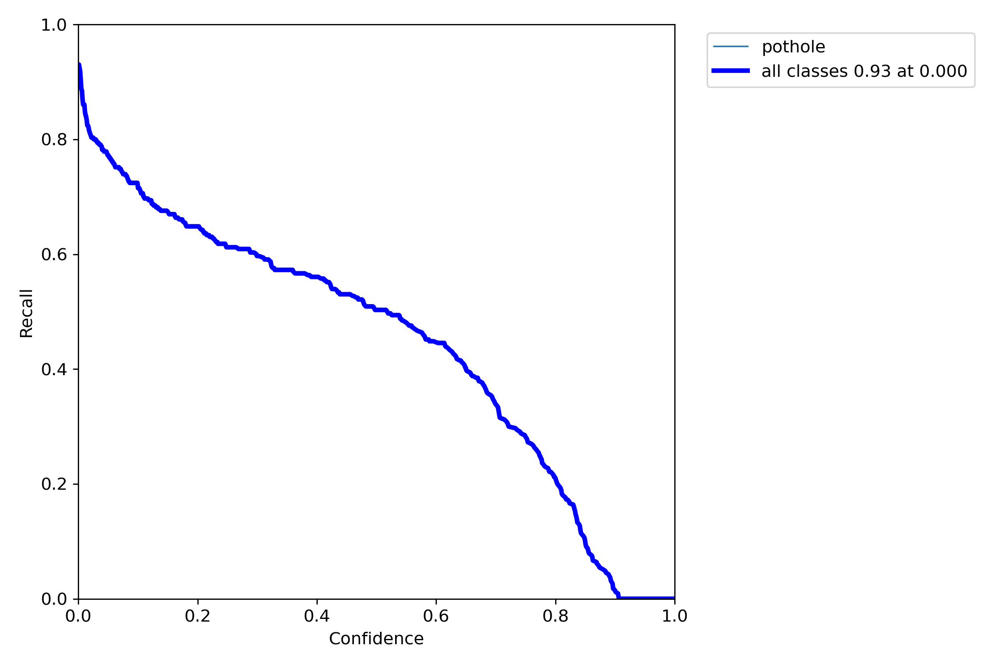

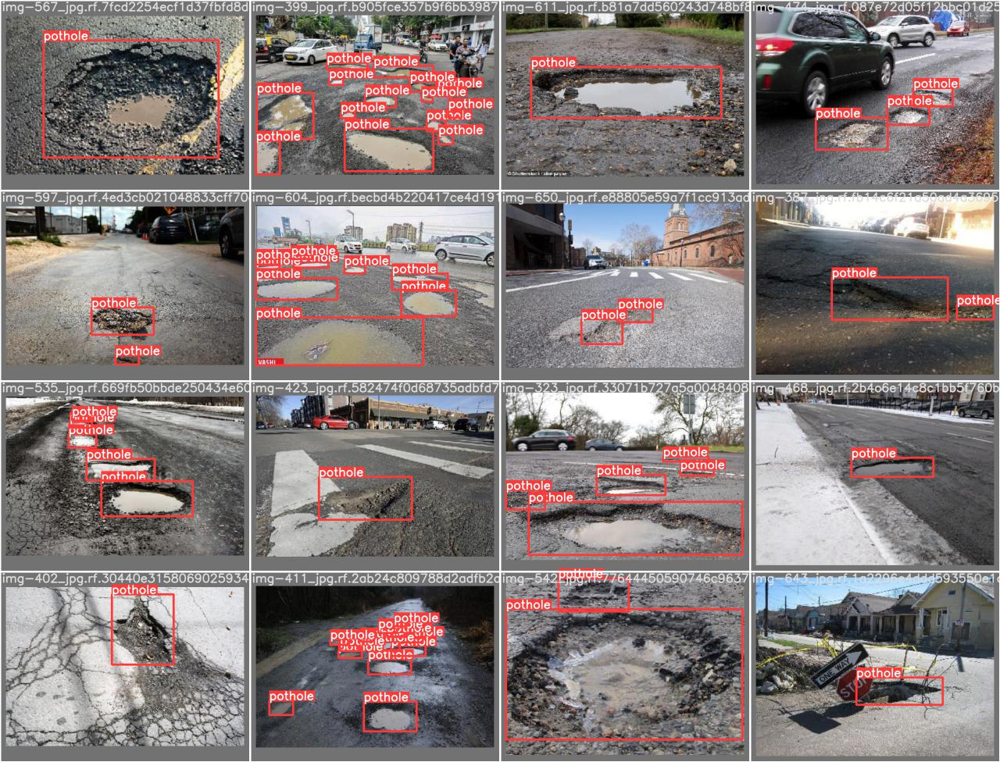

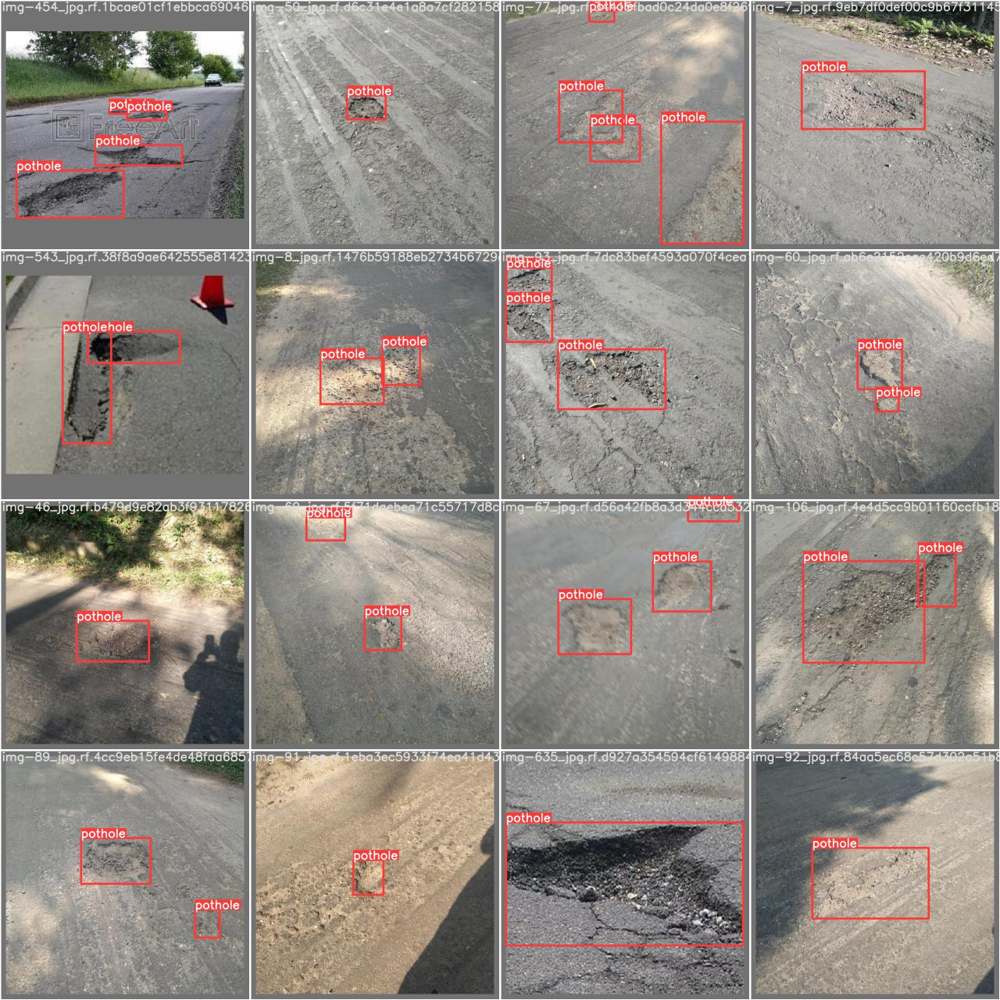

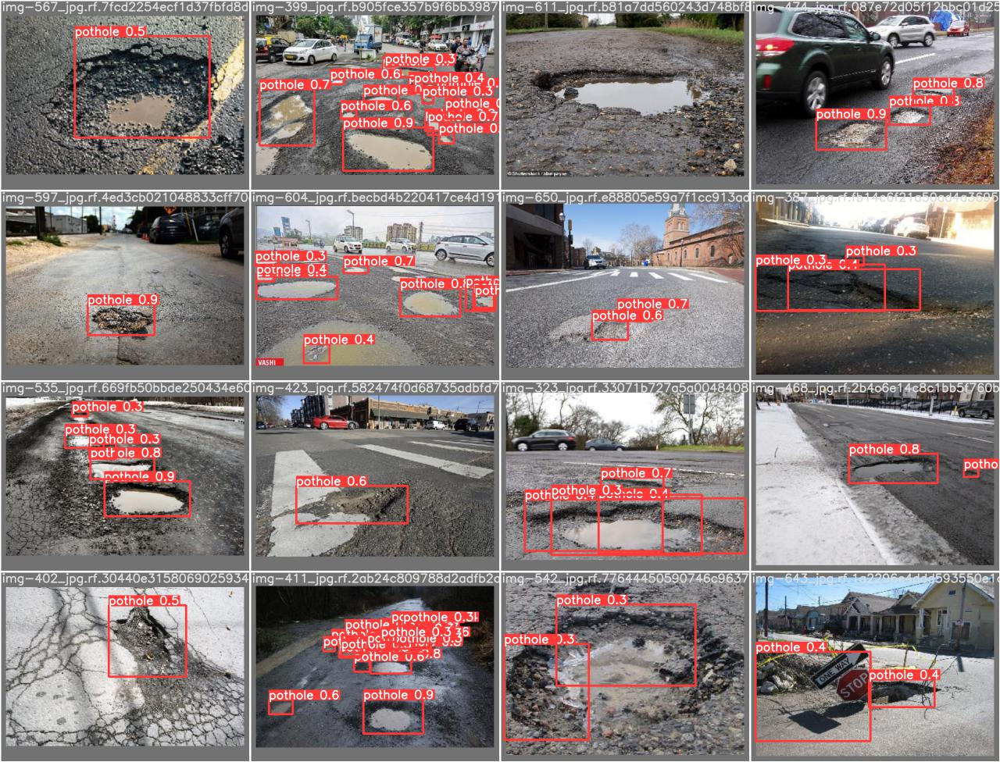

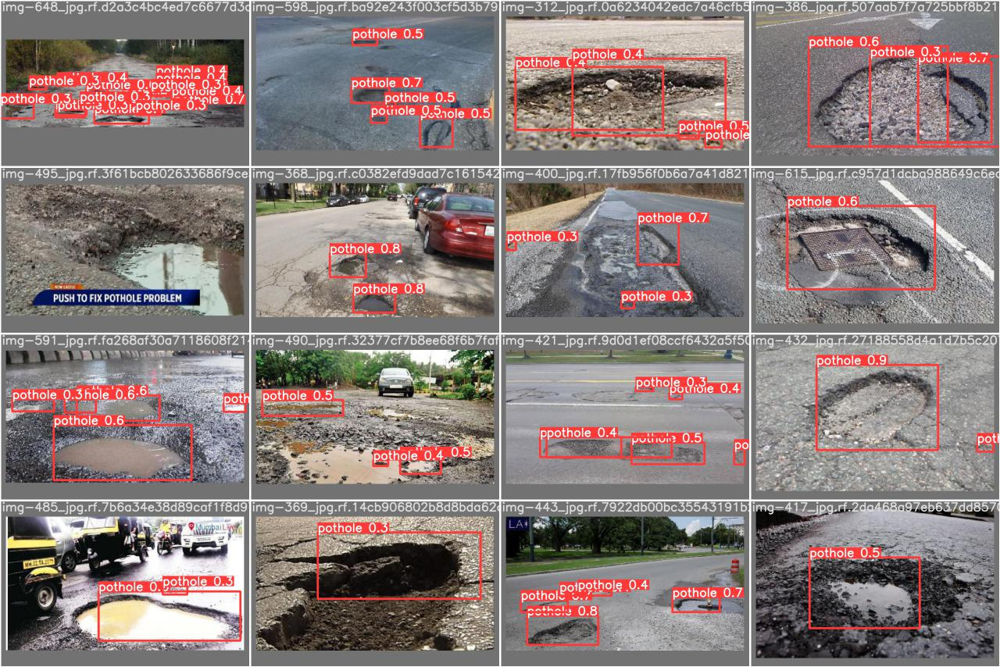

...

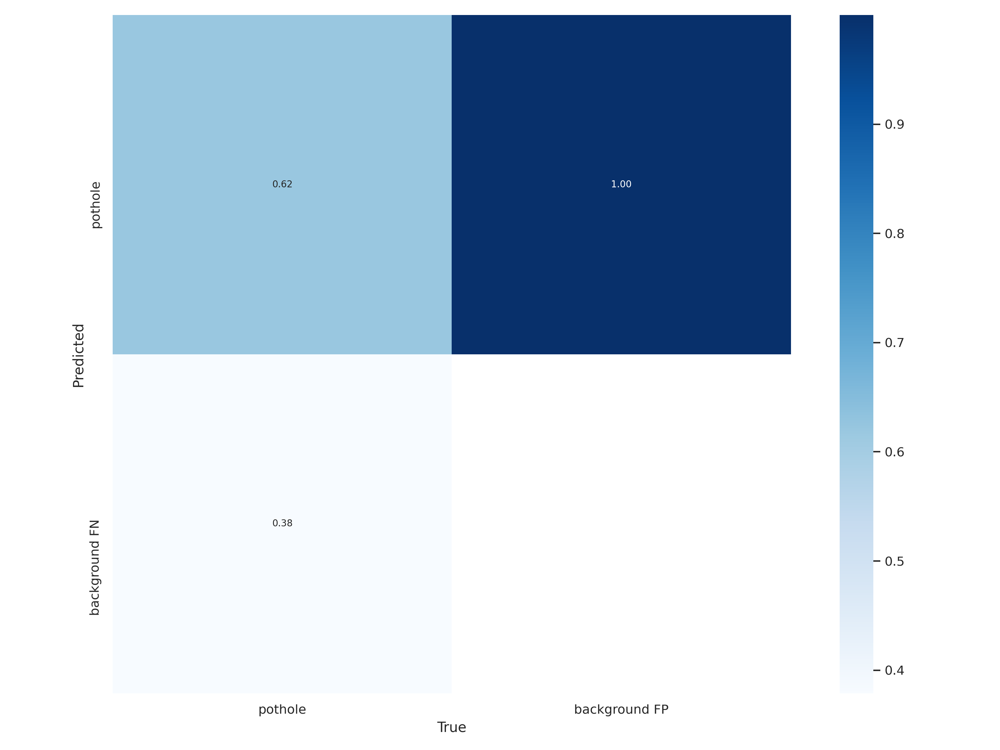

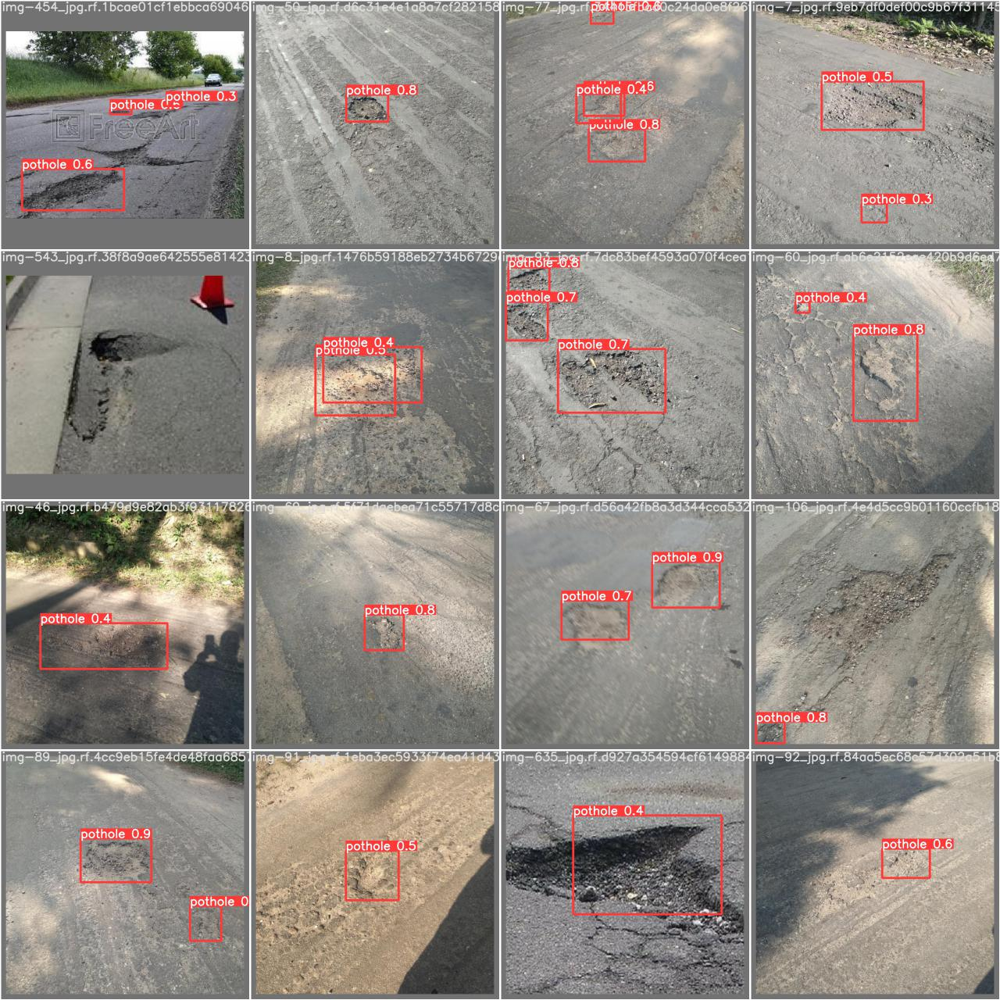

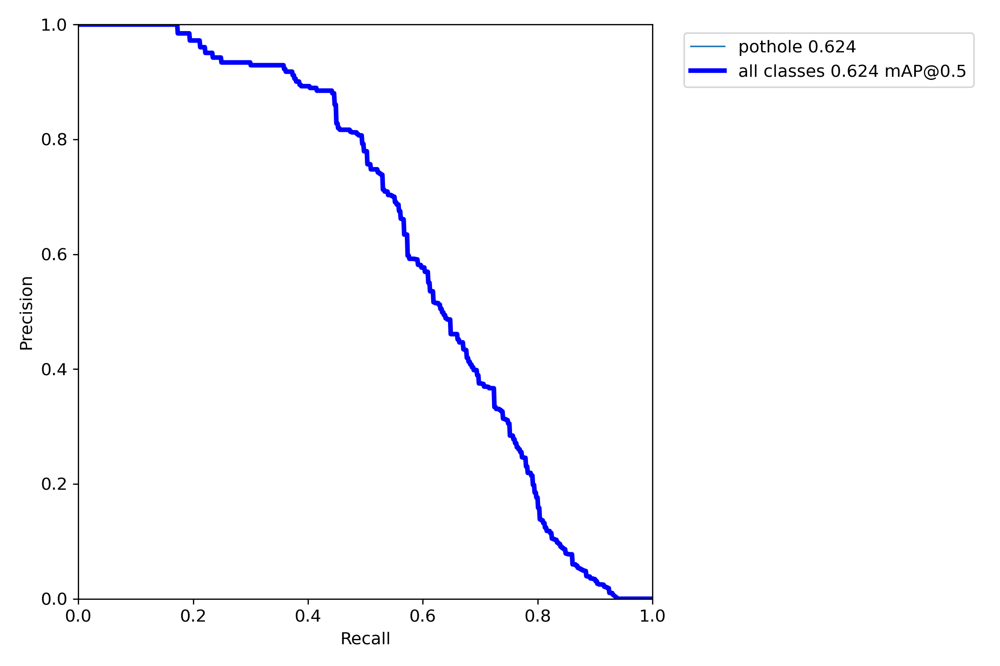

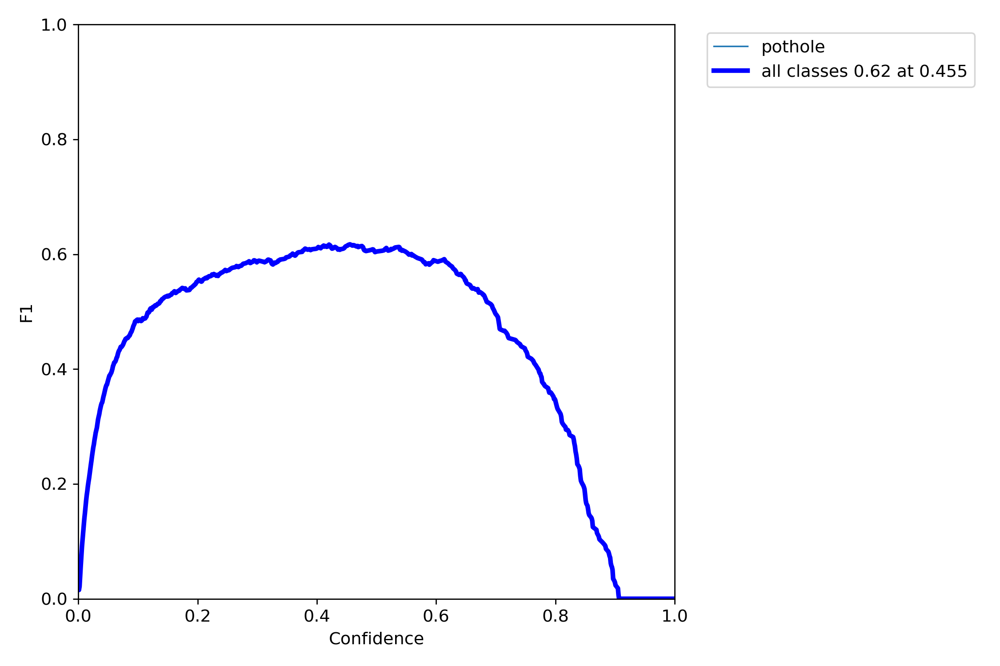

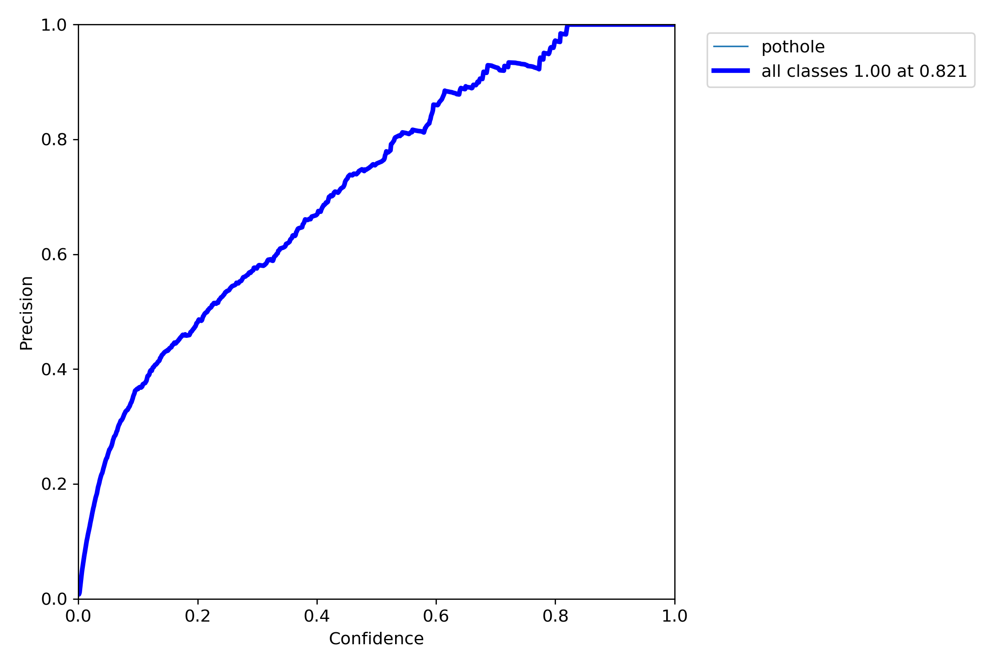

In [15]:
# Display Val images
import glob
from IPython.display import Image, display

for imageName in glob.glob("/content/yolov5/runs/val/my_yolo_model/*.*"): 
    display(Image(filename=imageName))
    print("\n")
    

In [16]:
# Inference 1 image :
%cd /content/yolov5/
!python detect.py --weights /content/yolov5/runs/train/pothole_model_results5/weights/best.pt --img 416 --conf 0.5 --source /content/my_dataset/test/images/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg


/content/yolov5
detect: weights=['/content/yolov5/runs/train/pothole_model_results5/weights/best.pt'], source=/content/my_dataset/test/images/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg, imgsz=416, conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-358-g3e7c59a torch 1.7.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 369 layers, 49808694 parameters, 0 gradients, 117.0 GFLOPs
image 1/1 /content/my_dataset/test/images/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg: 416x416 1 pothole, Done. (0.036s)
Results saved to runs/detect/exp
Done. (0.085s)


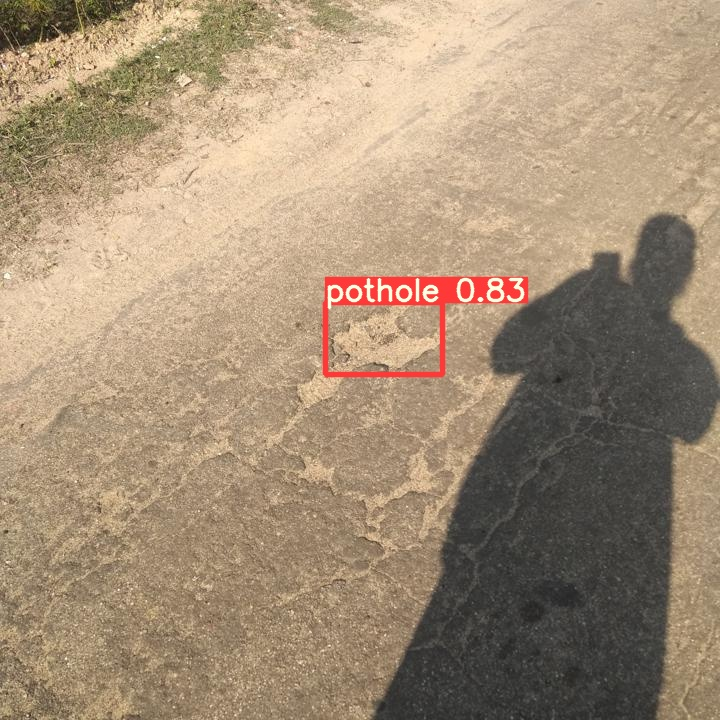

In [17]:
# display 1 image :
from IPython.display import Image, clear_output  # to display images
Image(filename="/content/yolov5/runs/detect/exp/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg", width=600)


In [19]:
# Inference all images :
%cd /content/yolov5/
!python detect.py --weights /content/yolov5/runs/train/pothole_model_results5/weights/best.pt --img 416 --conf 0.5 --source /content/my_dataset/test/images

/content/yolov5
detect: weights=['/content/yolov5/runs/train/pothole_model_results5/weights/best.pt'], source=/content/my_dataset/test/images, imgsz=416, conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-358-g3e7c59a torch 1.7.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 369 layers, 49808694 parameters, 0 gradients, 117.0 GFLOPs
image 1/67 /content/my_dataset/test/images/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg: 416x416 1 pothole, Done. (0.036s)
image 2/67 /content/my_dataset/test/images/img-107_jpg.rf.2e40485785f6e5e2efec404301b235c2.jpg: 416x416 1 pothole, Done. (0.035s)
image 3/67 /content/my_dataset/test/images/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.

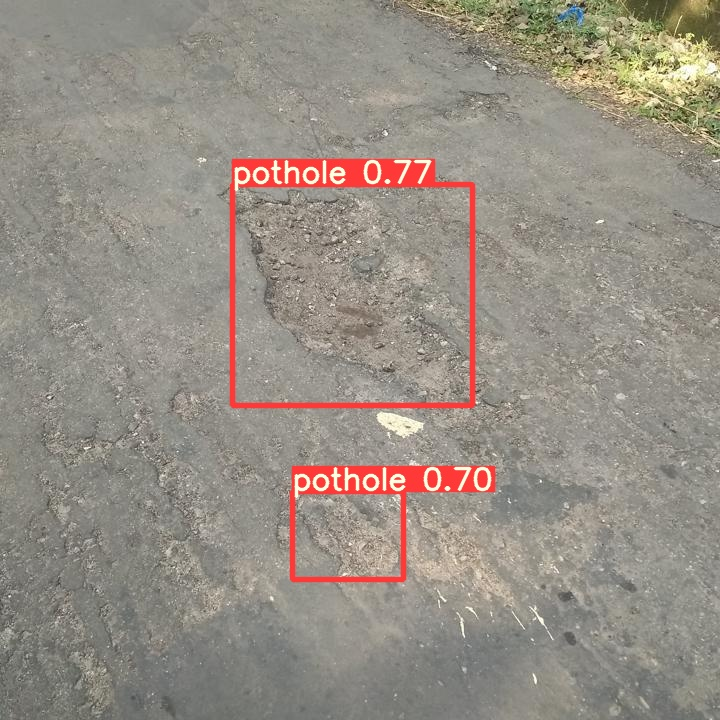

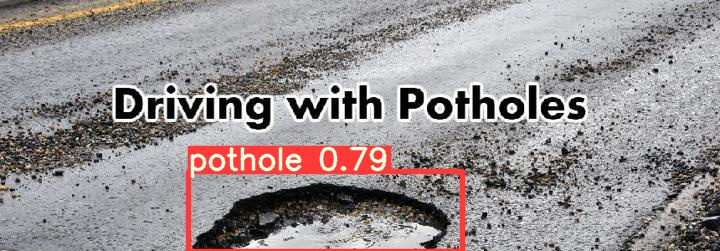

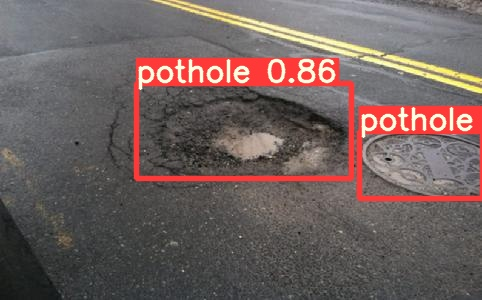

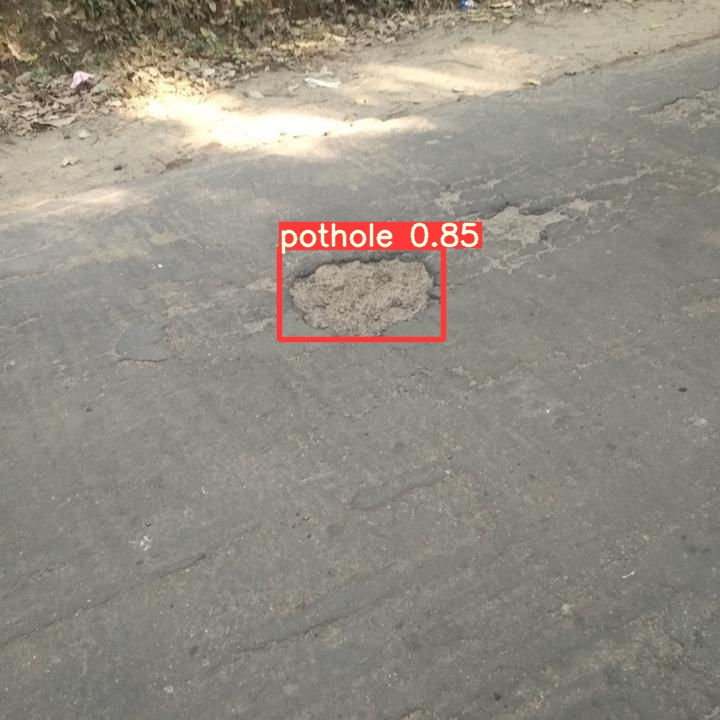

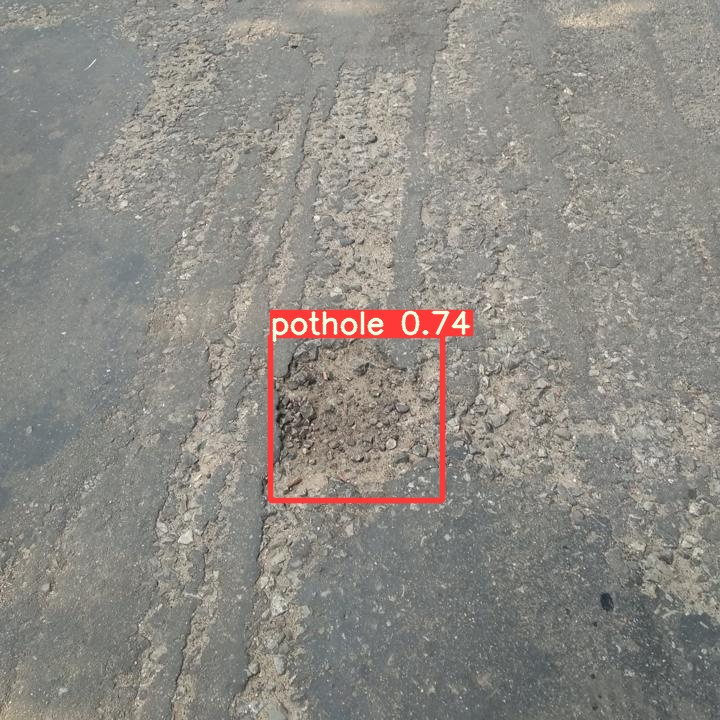

...

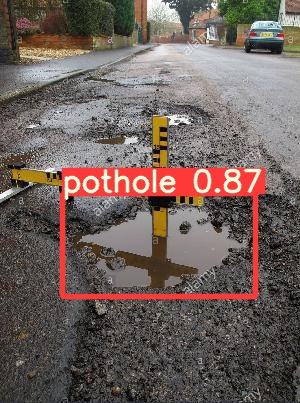

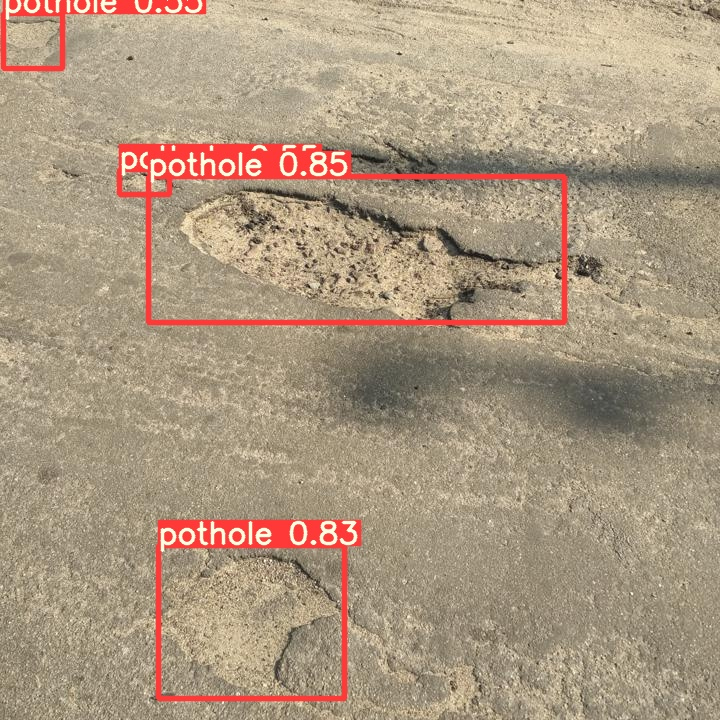

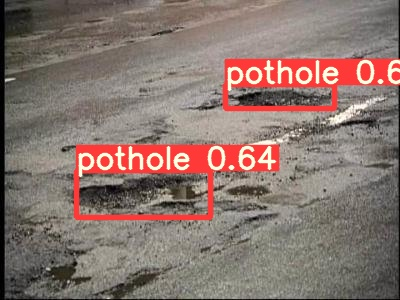

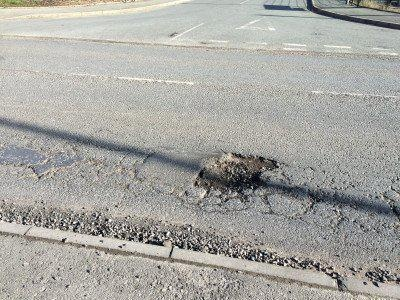

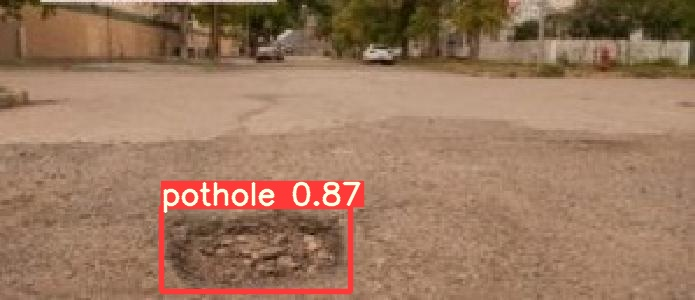

In [20]:

# Display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob("/content/yolov5/runs/detect/exp3/*.jpg"): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# **Saved Model**

In [42]:
# Inference all images by saved model:
%cd /content/yolov5/
!python detect.py --weights /content/gdrive/MyDrive/best.pt --img 416 --conf 0.4 --source /content/my_dataset/test/images

/content/yolov5
detect: weights=['/content/gdrive/MyDrive/best.pt'], source=/content/my_dataset/test/images, imgsz=416, conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-358-g3e7c59a torch 1.7.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 369 layers, 49808694 parameters, 0 gradients, 117.0 GFLOPs
image 1/67 /content/my_dataset/test/images/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg: 416x416 2 potholes, Done. (0.036s)
image 2/67 /content/my_dataset/test/images/img-107_jpg.rf.2e40485785f6e5e2efec404301b235c2.jpg: 416x416 1 pothole, Done. (0.035s)
image 3/67 /content/my_dataset/test/images/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.jpg: 416x416 1 pothole, Done. (0.

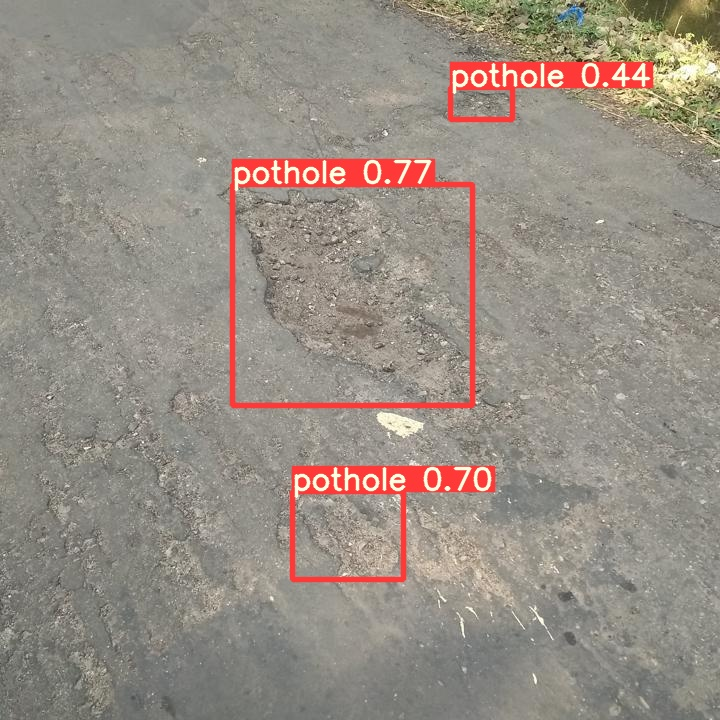

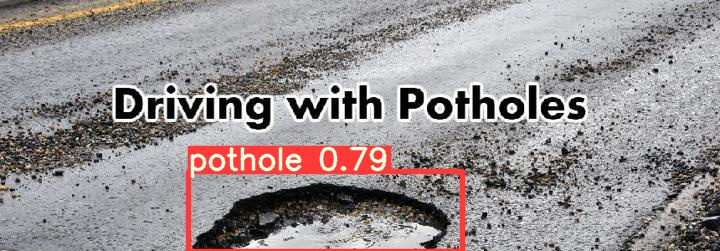

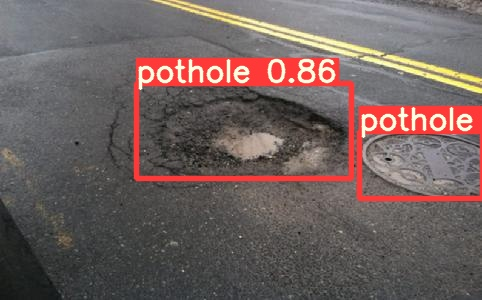

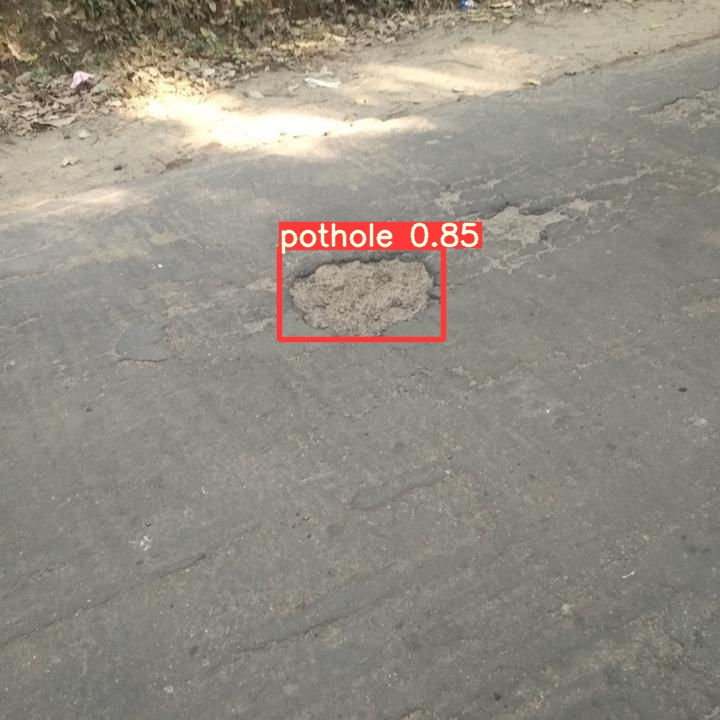

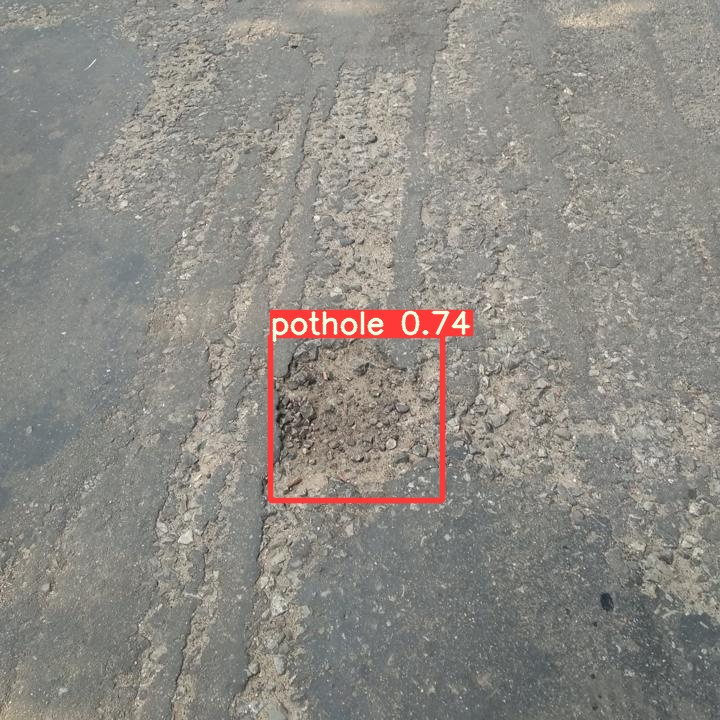

...

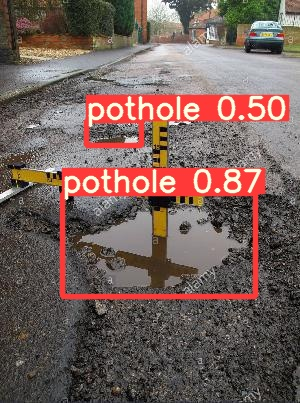

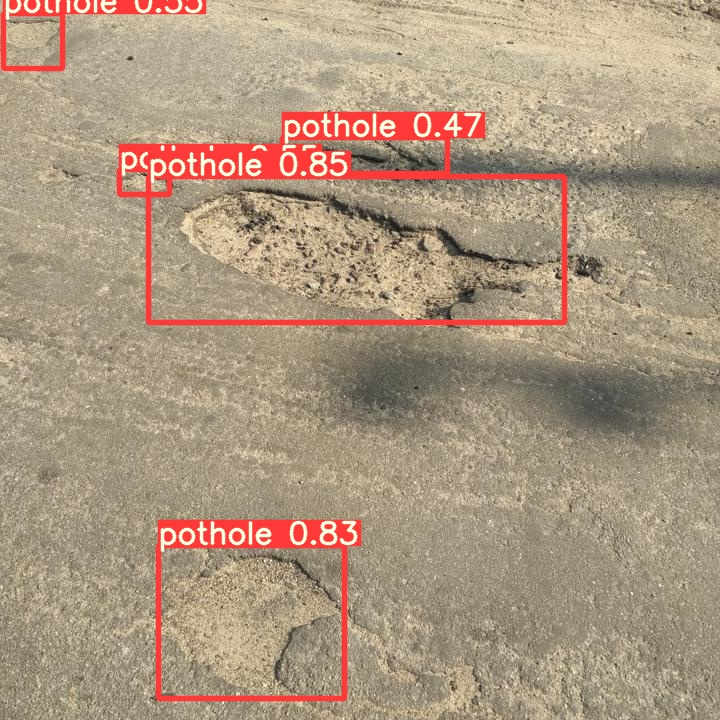

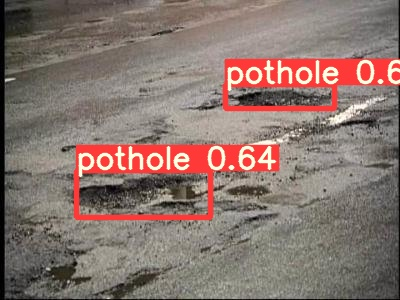

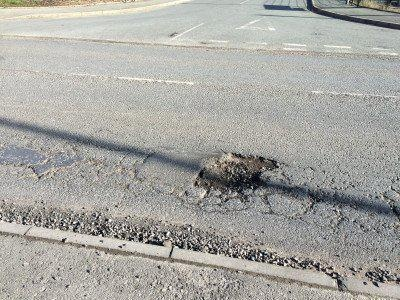

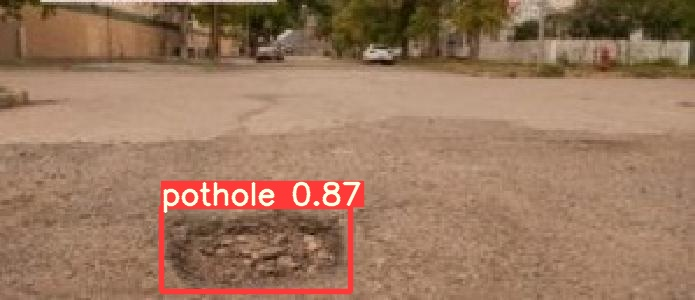

In [43]:
# display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob("/content/yolov5/runs/detect/exp6/*.jpg"): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# **Inference** 

In [23]:
# Python program to explain os.system() method 
      
# M1
"""
import os 
cmd = "python detect.py --weights /content/gdrive/MyDrive/best.pt --img 416 --conf 0.4 --source /content/my_dataset/test/images"   
os.system(cmd)
"""
# M2
"""
import subprocess
cmd = "python detect.py --weights /content/gdrive/MyDrive/best.pt --img 416 --conf 0.4 --source /content/my_dataset/test/images"
failure = subprocess.call(cmd, shell=True)
try:
    output = subprocess.check_output(cmd, shell=True,
                                     stderr=subprocess.STDOUT)
except subprocess.CalledProcessError:
    print('Execution of "%s" failed!\n' % cmd)
    sys.exit(1)

# Process output
for line in output.splitlines():
  print(line)
"""
# M3
import subprocess as sp
cmd = "python detect.py --save-txt --weights /content/gdrive/MyDrive/best.pt --img 416 --conf 0.4 --source /content/my_dataset/test/images/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.jpg"

output = sp.getoutput(cmd)
print (output)


YOLOv5 🚀 v5.0-358-g3e7c59a torch 1.7.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 369 layers, 49808694 parameters, 0 gradients, 117.0 GFLOPs
detect: weights=['/content/gdrive/MyDrive/best.pt'], source=/content/my_dataset/test/images/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.jpg, imgsz=416, conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
image 1/1 /content/my_dataset/test/images/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.jpg: 416x416 1 pothole, Done. (0.035s)
Results saved to runs/detect/exp5
1 labels saved to runs/detect/exp5/labels
Done. (0.055s)


9
Results saved to runs/detect/exp5
exp5
/content/yolov5/runs/detect/exp5/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.jpg


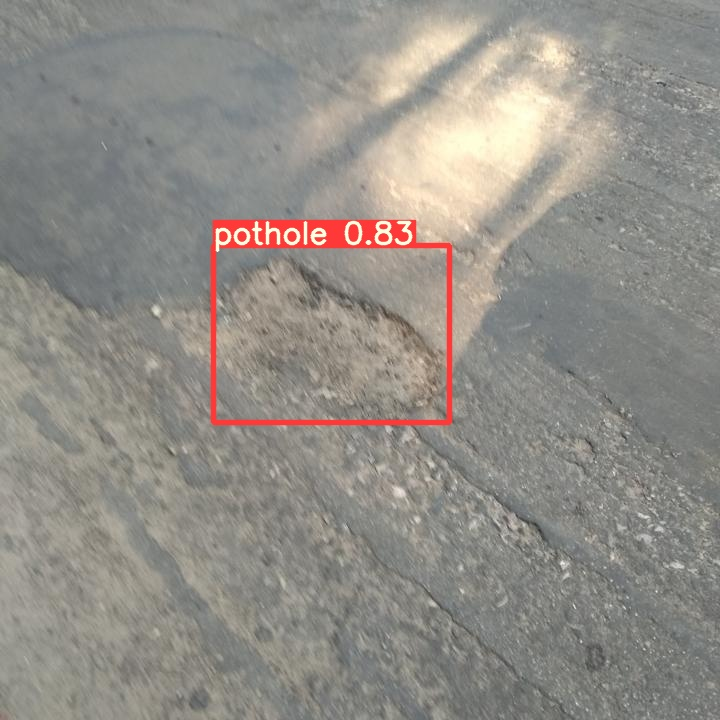

In [24]:
l = len(output.split("\n"))
print (l)
path_result = output.split("\n")[l-3]

print (path_result)
path_img = path_result.split("to ")[1]
path_img = path_img.encode()
path_img = str(path_img).split("/")[2].split("\\")[0]
print(path_img)
path_img = "/content/yolov5/runs/detect/"+path_img+"/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.jpg"
print(path_img)

import torch
from IPython.display import Image, clear_output  # to display images
Image(filename=path_img, width=600)

In [38]:
!pip install --upgrade gradio

In [2]:
# https://www.gradio.app/ml_examples

# Using saved model
import gradio as gr
import requests
import cv2
import subprocess as sp
from PIL import Image

print(gr.__version__)
def inference(img):
  my_image = img.name
  cmd = "python /content/yolov5/detect.py --save-txt --weights /content/gdrive/MyDrive/best.pt  --conf 0.5 --source "+my_image
  output = sp.getoutput(cmd)
  l = len(output.split("\n"))
  path_result = output.split("\n")[l-3]
  path_img = path_result.split("to ")[1]
  path_img = path_img.encode()
  path_img = str(path_img).split("/")[2].split("\\")[0]
  file_name = "runs/detect/"+path_img+"/"+my_image.split("/")[2]
  img_result = Image.open(file_name)
  return img_result


gr.Interface(fn=inference, inputs=gr.inputs.Image(type="file"), 
             outputs=gr.outputs.Image()).launch(share=True) #debug=True Use in Colab



2.2.8
Colab notebook detected. To show errors in colab notebook, set `debug=True` in `launch()`
This share link will expire in 24 hours. If you need a permanent link, visit: https://gradio.app/introducing-hosted (NEW!)
Running on External URL: https://52683.gradio.app
Interface loading below...


(<Flask 'gradio.networking'>,
 'http://127.0.0.1:7860/',
 'https://52683.gradio.app')